In [346]:

import pandas as pd
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
plt.style.use('ggplot')
from matplotlib.pyplot import figure

%matplotlib inline
matplotlib.rcParams['figure.figsize'] = (12,8) # adjusts the configuration of the plots we will create

df = pd.read_csv(r'C:\Users\hao\Downloads\archive (4)\movies.csv')


In [348]:
#Data first look
df.head()


,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000.0,46998772.0,Warner Bros.,146.0
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000.0,58853106.0,Columbia Pictures,104.0
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000.0,538375067.0,Lucasfilm,124.0
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000.0,83453539.0,Paramount Pictures,88.0
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000.0,39846344.0,Orion Pictures,98.0


In [111]:
# Missing data looking
for col in df.columns:
    pct_missing =  np.mean(df[col].isnull()).astype(str)
    print('{} - {}%'.format(col,pct_missing))

name - 0.0%
rating - 0.010041731872717789%
genre - 0.0%
year - 0.0%
released - 0.0002608242044861763%
score - 0.0003912363067292645%
votes - 0.0003912363067292645%
director - 0.0%
writer - 0.0003912363067292645%
star - 0.00013041210224308815%
country - 0.0003912363067292645%
budget - 0.2831246739697444%
gross - 0.02464788732394366%
company - 0.002217005738132499%
runtime - 0.0005216484089723526%


In [124]:
# DATA TYPE for each column
df.dtypes

name         object
rating       object
genre        object
year          int64
released     object
score       float64
votes       float64
director     object
writer       object
star         object
country      object
budget      float64
gross       float64
company      object
runtime     float64
dtype: object

In [130]:
#fill and converting data. As this is MCAR relevant to Movies data so omit it the suitable solution 
df_object = df[['name','rating','genre','year','released','director','writer','star','country','company']].fillna('None')

df_numeric = df[['name','score','votes','budget','gross','runtime']].fillna(0)

df_outer = pd.merge(df_object,df_numeric,on = 'name', how = 'outer')


df_outer['score'] = df_outer['score'].astype('int64')

df_outer['votes'] = df_outer['votes'].astype('int64')

df_outer['budget'] = df_outer['budget'].astype('int64')

df_outer['gross'] = df_outer['gross'].astype('int64')

df_outer['runtime'] = df_outer['runtime'].astype('int64')

df_outer.dtypes

name        object
rating      object
genre       object
year         int64
released    object
director    object
writer      object
star        object
country     object
company     object
score        int64
votes        int64
budget       int64
gross        int64
runtime      int64
dtype: object

In [310]:
#As there are some diffences in release and year, so we will fix it
#transform released col to str and pull the year with .str.split()
df_outer['yearcorrect'] = df_outer['released'].astype(str).str.split().str[2]
df_outer

,name,rating,genre,year,released,director,writer,star,country,company,score,votes,budget,gross,runtime,year_correct,yearcorrect
5854,Avatar,PG-13,Action,2009,"December 18, 2009 (United States)",James Cameron,James Cameron,Sam Worthington,United States,Twentieth Century Fox,7,1100000,237000000,2847246203,162,,2009
7785,Avengers: Endgame,PG-13,Action,2019,"April 26, 2019 (United States)",Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,Marvel Studios,8,903000,356000000,2797501328,181,,2019
3416,Titanic,PG-13,Drama,1997,"December 19, 1997 (United States)",James Cameron,James Cameron,Leonardo DiCaprio,United States,Twentieth Century Fox,7,1100000,200000000,2201647264,194,,1997
7028,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,"December 18, 2015 (United States)",J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,Lucasfilm,7,876000,245000000,2069521700,138,,2015
7592,Avengers: Infinity War,PG-13,Action,2018,"April 27, 2018 (United States)",Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,Marvel Studios,8,897000,321000000,2048359754,149,,2018
2781,The Lion King,G,Animation,1994,"June 24, 1994 (United States)",Roger Allers,Irene Mecchi,Matthew Broderick,United States,Walt Disney Pictures,6,222000,260000000,1670727580,118,,1994
2783,The Lion King,PG,Animation,2019,"July 19, 2019 (United States)",Jon Favreau,Jeff Nathanson,Donald Glover,United States,Walt Disney Pictures,6,222000,260000000,1670727580,118,,2019
7018,Jurassic World,PG-13,Action,2015,"June 12, 2015 (United States)",Colin Trevorrow,Rick Jaffa,Chris Pratt,United States,Universal Pictures,7,593000,150000000,1670516444,124,,2015
3704,The Avengers,PG-13,Action,1998,"August 14, 1998 (United States)",Jeremiah S. Chechik,Sydney Newman,Ralph Fiennes,United States,Warner Bros.,8,1300000,220000000,1518815515,143,,1998
3706,The Avengers,PG-13,Action,2012,"May 4, 2012 (United States)",Joss Whedon,Joss Whedon,Robert Downey Jr.,United States,Marvel Studios,8,1300000,220000000,1518815515,143,,2012


In [384]:
# use sort_values to sort by gross descending and Show it with inplace = False
df_outer.sort_values(by=['gross'], inplace = False, ascending=False)

,name,rating,genre,year,released,director,writer,star,country,company,score,votes,budget,gross,runtime
5854,Avatar,PG-13,Action,2009,"December 18, 2009 (United States)",James Cameron,James Cameron,Sam Worthington,United States,Twentieth Century Fox,7,1100000,237000000,2847246203,162
7785,Avengers: Endgame,PG-13,Action,2019,"April 26, 2019 (United States)",Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,Marvel Studios,8,903000,356000000,2797501328,181
3416,Titanic,PG-13,Drama,1997,"December 19, 1997 (United States)",James Cameron,James Cameron,Leonardo DiCaprio,United States,Twentieth Century Fox,7,1100000,200000000,2201647264,194
7028,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,"December 18, 2015 (United States)",J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,Lucasfilm,7,876000,245000000,2069521700,138
7592,Avengers: Infinity War,PG-13,Action,2018,"April 27, 2018 (United States)",Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,Marvel Studios,8,897000,321000000,2048359754,149
2781,The Lion King,G,Animation,1994,"June 24, 1994 (United States)",Roger Allers,Irene Mecchi,Matthew Broderick,United States,Walt Disney Pictures,6,222000,260000000,1670727580,118
2783,The Lion King,PG,Animation,2019,"July 19, 2019 (United States)",Jon Favreau,Jeff Nathanson,Donald Glover,United States,Walt Disney Pictures,6,222000,260000000,1670727580,118
7018,Jurassic World,PG-13,Action,2015,"June 12, 2015 (United States)",Colin Trevorrow,Rick Jaffa,Chris Pratt,United States,Universal Pictures,7,593000,150000000,1670516444,124
3704,The Avengers,PG-13,Action,1998,"August 14, 1998 (United States)",Jeremiah S. Chechik,Sydney Newman,Ralph Fiennes,United States,Warner Bros.,8,1300000,220000000,1518815515,143
3706,The Avengers,PG-13,Action,2012,"May 4, 2012 (United States)",Joss Whedon,Joss Whedon,Robert Downey Jr.,United States,Marvel Studios,8,1300000,220000000,1518815515,143


In [378]:
#Drop any duplicates (can do with many row), sort_value also show unique value
df = df.sort_values(by=['gross'], inplace=False, ascending=False)

In [275]:
#find a certain text == same as Like in SQL
a = pd.Series(df_outer['company'])
a.str.contains('Walt')

5854    False
7785    False
3416    False
7028    False
7592    False
2781     True
2783     True
7018    False
3704    False
3706    False
7011    False
7828     True
7009    False
7595    False
6249    False
7427     True
7618    False
6147     True
6145    False
2155    False
2153     True
7627     True
7408    False
6624    False
7051    False
7203    False
7598    False
4647    False
7796    False
7794     True
6281    False
6452    False
6865    False
2780     True
2782     True
6440    False
7801     True
7789    False
7822    False
6092     True
5255     True
7224    False
2370     True
2368     True
6263     True
7488    False
2567    False
7261    False
3848    False
6075     True
7218     True
6438    False
4253    False
5651    False
6057    False
6688    False
2843    False
2845    False
7404    False
6829    False
5466     True
6633    False
4453    False
5457    False
4664    False
5860    False
4881    False
7594    False
4255    False
5048    False
5463    False
5948  

In [ ]:
# Budget high correlation
# comapnay high correlation

<function matplotlib.pyplot.show(close=None, block=None)>

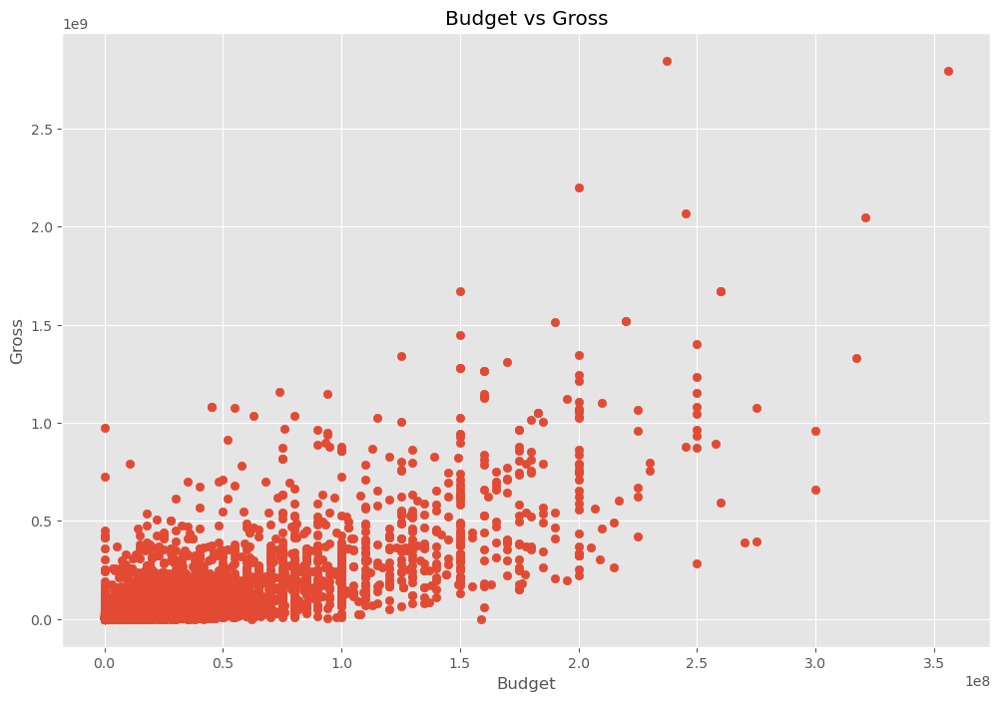

In [283]:
# Scatter plot with budget vs gross

plt.scatter(x=df_outer['budget'], y=df_outer['gross'])

plt.title('Budget vs Gross')

plt.xlabel('Budget')

plt.ylabel('Gross')

plt.show

<Axes: xlabel='budget', ylabel='gross'>

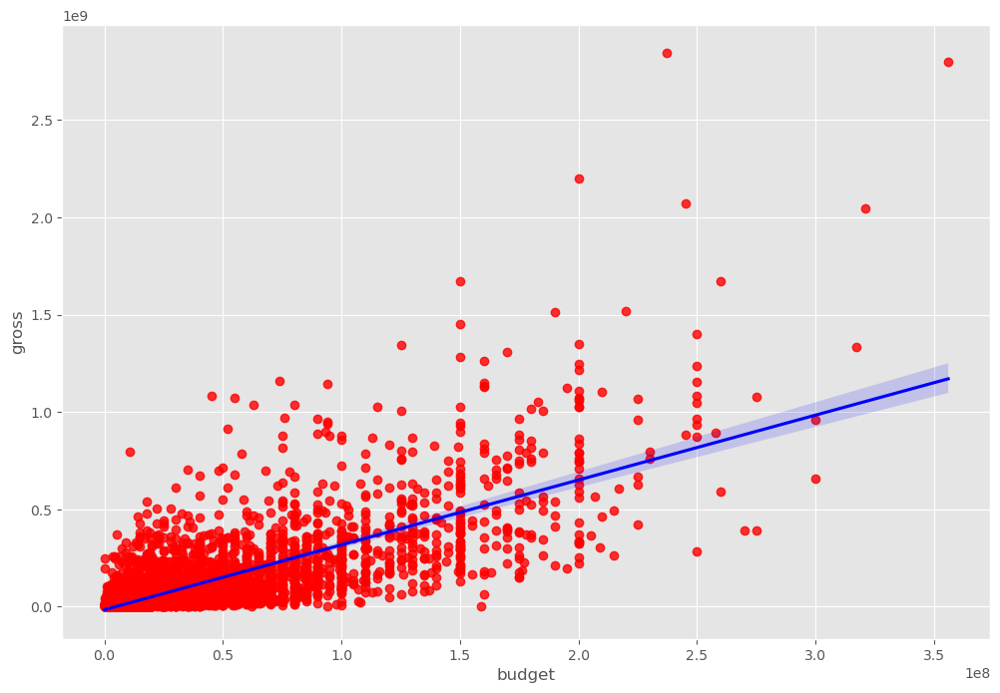

In [381]:
#plot budget vs gross using seaborn

sns.regplot(x='budget', y='gross', data = df, scatter_kws = {"color" : "red"}, line_kws={"color" : "Blue"})

In [379]:
# Let's start looking at correlation
df.head()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
5445,Avatar,PG-13,Action,2009,"December 18, 2009 (United States)",7.8,1100000.0,James Cameron,James Cameron,Sam Worthington,United States,237000000.0,2.847246e+09,Twentieth Century Fox,162.0
7445,Avengers: Endgame,PG-13,Action,2019,"April 26, 2019 (United States)",8.4,903000.0,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,356000000.0,2.797501e+09,Marvel Studios,181.0
3045,Titanic,PG-13,Drama,1997,"December 19, 1997 (United States)",7.8,1100000.0,James Cameron,James Cameron,Leonardo DiCaprio,United States,200000000.0,2.201647e+09,Twentieth Century Fox,194.0
6663,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,"December 18, 2015 (United States)",7.8,876000.0,J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,245000000.0,2.069522e+09,Lucasfilm,138.0
7244,Avengers: Infinity War,PG-13,Action,2018,"April 27, 2018 (United States)",8.4,897000.0,Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,321000000.0,2.048360e+09,Marvel Studios,149.0


In [403]:
#convert string to float as Nan
#df_outer.assign(name = pd.to_numeric(df['name'],errors='coerce'))

In [301]:
#pearson, kendall, spearman

In [405]:
#if table have text, numeric_only = True, if not numeric_only = False
df_outer.corr(method='pearson', min_periods=1, numeric_only = True)

,year,score,votes,budget,gross,runtime
year,1.000000,0.092978,0.211404,0.287900,0.242074,0.106287
score,0.092978,1.000000,0.394152,0.055221,0.179863,0.379178
votes,0.211404,0.394152,1.000000,0.489174,0.633427,0.306251
budget,0.287900,0.055221,0.489174,1.000000,0.749171,0.268450
gross,0.242074,0.179863,0.633427,0.749171,1.000000,0.239936
runtime,0.106287,0.379178,0.306251,0.268450,0.239936,1.000000


<function matplotlib.pyplot.show(close=None, block=None)>

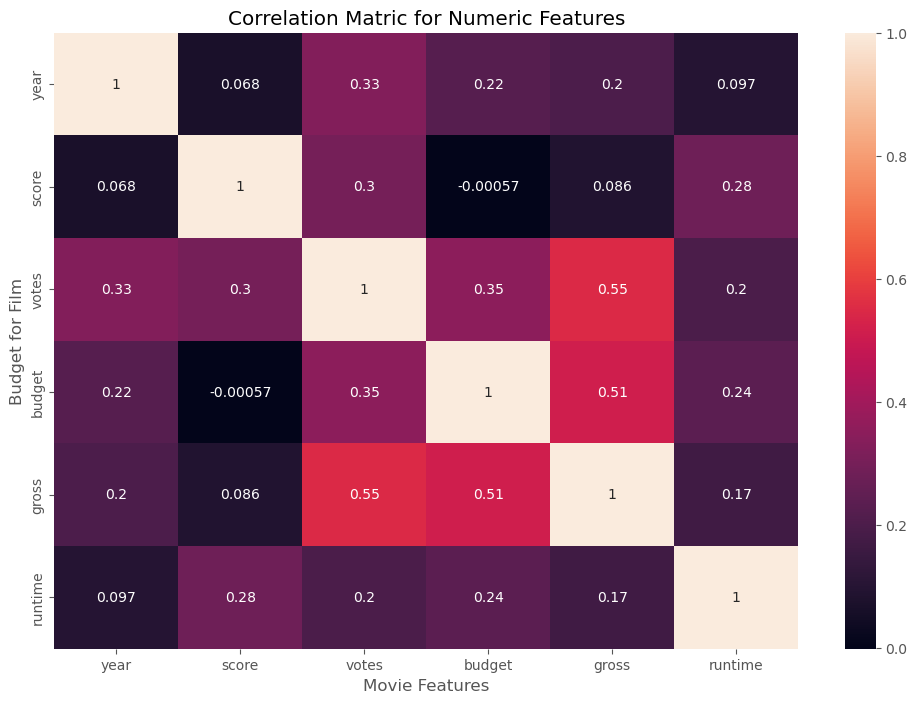

In [409]:
# High correlation between budget and gross
correlation_matrix = df.corr(method='kendall', min_periods=1, numeric_only = True)

sns.heatmap(correlation_matrix, annot = True)

plt.title('Correlation Matric for Numeric Features')

plt.xlabel('Movie Features')

plt.ylabel('Budget for Film')

plt.show

In [411]:
#Look at company
df_outer.head()

,name,rating,genre,year,released,director,writer,star,country,company,score,votes,budget,gross,runtime
5854,Avatar,PG-13,Action,2009,"December 18, 2009 (United States)",James Cameron,James Cameron,Sam Worthington,United States,Twentieth Century Fox,7,1100000,237000000,2847246203,162
7785,Avengers: Endgame,PG-13,Action,2019,"April 26, 2019 (United States)",Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,Marvel Studios,8,903000,356000000,2797501328,181
3416,Titanic,PG-13,Drama,1997,"December 19, 1997 (United States)",James Cameron,James Cameron,Leonardo DiCaprio,United States,Twentieth Century Fox,7,1100000,200000000,2201647264,194
7028,Star Wars: Episode VII - The Force Awakens,PG-13,Action,2015,"December 18, 2015 (United States)",J.J. Abrams,Lawrence Kasdan,Daisy Ridley,United States,Lucasfilm,7,876000,245000000,2069521700,138
7592,Avengers: Infinity War,PG-13,Action,2018,"April 27, 2018 (United States)",Anthony Russo,Christopher Markus,Robert Downey Jr.,United States,Marvel Studios,8,897000,321000000,2048359754,149


In [415]:
#numerize
df_outer_numerize = df_outer

for col_name in df_outer_numerize.columns:
    if(df_outer_numerize[col_name].dtype == 'object'):
        df_outer_numerize[col_name] = df_outer_numerize[col_name].astype('category')
        df_outer_numerize[col_name] = df_outer_numerize[col_name].cat.codes   
        
df_outer_numerize

,name,rating,genre,year,released,director,writer,star,country,company,score,votes,budget,gross,runtime
5854,533,6,0,2009,696,1155,1778,2335,56,2254,7,1100000,237000000,2847246203,162
7785,535,6,0,2019,183,162,743,2242,56,1606,8,903000,356000000,2797501328,181
3416,6896,6,6,1997,704,1155,1778,1595,56,2254,7,1100000,200000000,2201647264,194
7028,5144,6,0,2015,698,1125,2550,524,56,1540,7,876000,245000000,2069521700,138
7592,536,6,0,2018,192,162,743,2242,56,1606,8,897000,321000000,2048359754,149
2781,6194,1,2,1994,1811,2415,1702,1797,56,2317,6,222000,260000000,1670727580,118
2783,6194,5,2,2019,1488,1455,1919,676,56,2317,6,222000,260000000,1670727580,118
7018,2969,6,0,2015,1704,517,3569,437,56,2282,7,593000,150000000,1670516444,124
3704,5502,6,0,1998,336,1273,4121,2169,56,2320,8,1300000,220000000,1518815515,143
3706,5502,6,0,2012,2472,1517,2314,2242,56,1606,8,1300000,220000000,1518815515,143


<function matplotlib.pyplot.show(close=None, block=None)>

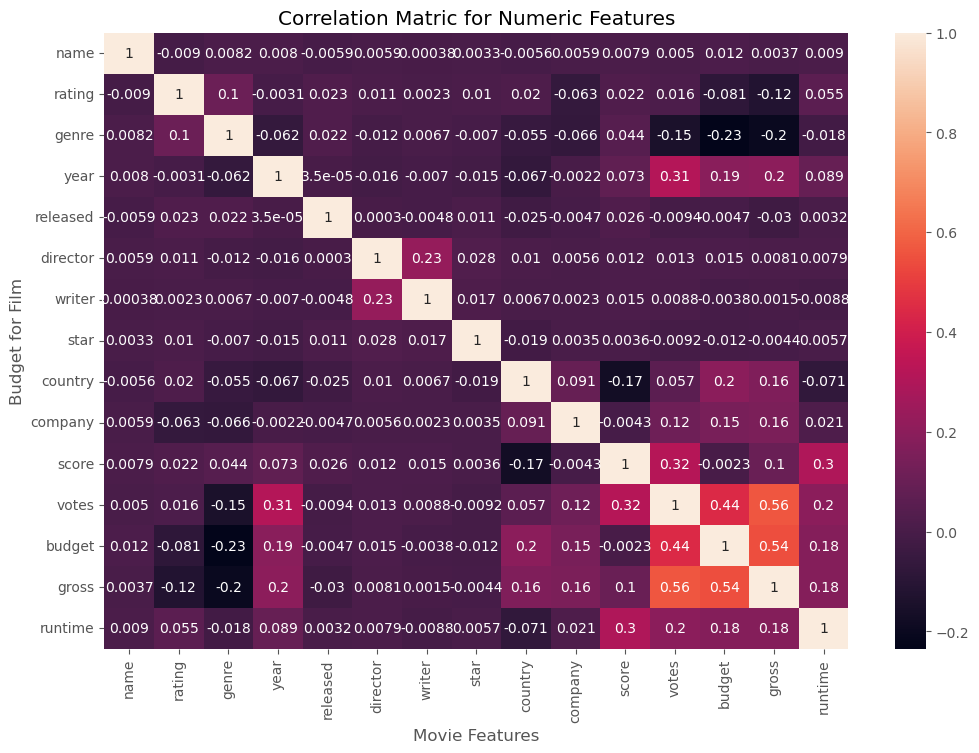

In [416]:
correlation_matrix = df_outer_numerize.corr(method='kendall', min_periods=1, numeric_only = True)

sns.heatmap(correlation_matrix, annot = True)

plt.title('Correlation Matric for Numeric Features')

plt.xlabel('Movie Features')

plt.ylabel('Budget for Film')

plt.show

In [420]:
# Use unstack to pair value
correclation_matrix = df_outer_numerize.corr()
correlation_pair = correlation_matrix.unstack()
correlation_pair

name      name        1.000000
          rating     -0.008968
          genre       0.008218
          year        0.008014
          released   -0.005907
          director    0.005935
          writer      0.000383
          star        0.003342
          country    -0.005637
          company     0.005862
          score       0.007918
          votes       0.005002
          budget      0.012330
          gross       0.003666
          runtime     0.009050
rating    name       -0.008968
          rating      1.000000
          genre       0.103219
          year       -0.003059
          released    0.022961
          director    0.010943
          writer      0.002350
          star        0.010337
          country     0.019843
          company    -0.062656
          score       0.021791
          votes       0.015751
          budget     -0.080807
          gross      -0.119910
          runtime     0.054995
genre     name        0.008218
          rating      0.103219
        

In [424]:
#use sort_value to arrange 
sorted_correlation = correlation_pair.sort_values()

In [426]:
#use value that greater than 0.5
high_correlation = sorted_correlation[(sorted_correlation) > 0.5]
high_correlation

budget    gross       0.542537
gross     budget      0.542537
          votes       0.563900
votes     gross       0.563900
name      name        1.000000
star      star        1.000000
budget    budget      1.000000
votes     votes       1.000000
score     score       1.000000
company   company     1.000000
country   country     1.000000
writer    writer      1.000000
director  director    1.000000
released  released    1.000000
year      year        1.000000
genre     genre       1.000000
rating    rating      1.000000
gross     gross       1.000000
runtime   runtime     1.000000
dtype: float64